#**Environment**

## Notas de Jorge - revisión inicial del EDA

In [ ]:
!pip install ydata_profiling
!pip install ipwyidgets

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
from ydata_profiling import ProfileReport
from scipy import stats
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import FunctionTransformer


DIR = '/content/drive/MyDrive/MLOps'
os.chdir(DIR)

#**Absenteeism at Work**

##**Dataset**

In [ ]:
df = pd.read_csv('work_absenteeism_modified.csv')

##**Analysis**

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 754 entries, 0 to 753
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   ID                               746 non-null    object 
 1   Reason for absence               748 non-null    object 
 2   Month of absence                 743 non-null    object 
 3   Day of the week                  746 non-null    object 
 4   Seasons                          750 non-null    object 
 5   Transportation expense           746 non-null    object 
 6   Distance from Residence to Work  743 non-null    object 
 7   Service time                     747 non-null    object 
 8   Age                              749 non-null    object 
 9   Work load Average/day            741 non-null    object 
 10  Hit target                       746 non-null    object 
 11  Disciplinary failure             747 non-null    object 
 12  Education             

##**Data Cleaning**

##### **🗑️ Removed Variables**

| Variable          | Reason for Removal                                               |
|-------------------|-----------------------------------------------------------------|
| `ID`              | It's a unique identifier with no predictive value.              |
| `mixed_type_col`  | Contained mixed or inconsistent values that didn't provide useful information to the model. |

These columns were removed at the beginning of the pipeline to reduce noise and prevent errors during later processing.

---

##### **🔠 Categorical Variables**

| Variable              | Applied Transformation                                 | Justification                                                                                  |
|-----------------------|-------------------------------------------------------|-----------------------------------------------------------------------------------------------|
| `Reason for absence`   | Values outside the `0–28` range were replaced with `0` (`Unknown`). | Ensures consistency with the defined code mapping and avoids errors from corrupt values.      |
| `Month of absence`     | Values outside the `0–12` range were replaced with `0` (`Unknown`). | Ensures consistency with the defined code mapping and avoids errors from corrupt values.      |
| `Day of the week`      | Values outside the `2–6` range were imputed with the mode.          | Only workdays exist in this dataset; imputing with the most frequent value prevents distortion. |
| `Seasons`              | Values outside the `1–4` range were imputed with the mode.          | Limited to 4 seasons; imputing the mode avoids data loss.                                     |
| `Education`            | Values outside the `1–4` range were imputed with the mode.          | Only valid education levels are retained; the mode preserves general distribution.            |
| `Disciplinary failure` | Values other than `0` or `1` were imputed with the mode.            | This binary variable must be 0 or 1; errors were corrected without introducing bias.          |
| `Social drinker`       | Values other than `0` or `1` were imputed with the mode.            | Ensures consistency in this binary variable.                                                  |
| `Social smoker`        | Values other than `0` or `1` were imputed with the mode.            | Maintains integrity of binary data.                                                           |

---

##### **🔢 Numerical Variables**

| Variable                  | Applied Transformations                           | Justification                                                         |
|---------------------------|-------------------------------------------------|----------------------------------------------------------------------|
| `Transportation expense`   | IQR Winsorization + Median Imputation + Final Rounding | Controls outliers, fills in missing values, and formats as integers for modeling. |
| `Distance from Residence to Work` | IQR Winsorization + Median Imputation + Final Rounding | Normalizes distribution and ensures numerical integrity.             |
| `Service time`            | IQR Winsorization + Median Imputation + Final Rounding | Improves consistency in employment-related data.                      |
| `Age`                     | IQR Winsorization + Median Imputation + Final Rounding | Ensures a logical age range and complete data.                        |
| `Work load Average/day`   | IQR Winsorization + Median Imputation + Final Rounding | Reduces impact of extreme values and fills in missing data.          |
| `Hit target`              | IQR Winsorization + Median Imputation + Final Rounding | Adjusts the variable to a realistic and coherent range.              |
| `Son`                     | IQR Winsorization + Median Imputation + Final Rounding | Though discrete, extreme and missing values are treated.             |
| `Pet`                     | IQR Winsorization + Median Imputation + Final Rounding | Kept as an integer while controlling for outliers.                   |
| `Weight`                  | IQR Winsorization + Median Imputation + Final Rounding | Ensures values fall within a physiologically plausible range.         |
| `Height`                  | IQR Winsorization + Median Imputation + Final Rounding | Controls for logical range and completes data.                        |
| `Body mass index`         | IQR Winsorization + Median Imputation + Final Rounding | Improves consistency of this index derived from weight and height.   |
| `Absenteeism time in hours` | IQR Winsorization + Median Imputation + Final Rounding | Target variable; cleaned to avoid bias and prediction errors.        |

---

##### **Preprocessing**

The overall goal was to **correct invalid values, handle outliers, and fill in missing data**.


####**Auxiliary Functions**

In [ ]:
def drop_columns(df):
    return df.drop(['ID', 'mixed_type_col'], axis=1)


def strip_object_columns(df):
    df_obj = df.select_dtypes(include='object').copy()
    for col in df_obj.columns:
        df[col] = df[col].astype(str).str.strip()
    return df


def safe_round_to_int_df(df):
    def safe_convert(val):
        try:
            if pd.isnull(val):
                return np.nan
            return round(float(val))
        except:
            return np.nan

    for col in df.columns:
        df[col] = df[col].apply(safe_convert)
    return df


def fix_invalid_values(df):
    df['Reason for absence'] = df['Reason for absence'].apply(lambda x: x if x in range(0, 29) else 0)
    df['Month of absence'] = df['Month of absence'].apply(lambda x: x if x in range(0, 13) else 0)
    df['Day of the week'] = df['Day of the week'].apply(lambda x: x if x in range(2, 7) else df['Day of the week'].mode()[0])
    df['Seasons'] = df['Seasons'].apply(lambda x: x if x in range(1, 5) else df['Seasons'].mode()[0])
    df['Education'] = df['Education'].apply(lambda x: x if x in range(1, 5) else df['Education'].mode()[0])

    binary_cols = ['Disciplinary failure', 'Social drinker', 'Social smoker']
    for col in binary_cols:
        df[col] = df[col].apply(lambda x: x if x in [0, 1] else df[col].mode()[0])

    return df


def winsorize_iqr(df):
    num_cols = [
        'Transportation expense', 'Distance from Residence to Work', 'Service time',
        'Age', 'Work load Average/day', 'Hit target', 'Son', 'Pet', 'Weight',
        'Height', 'Body mass index', 'Absenteeism time in hours'
    ]

    for col in num_cols:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df[col] = df[col].clip(lower=lower_bound, upper=upper_bound)
    return df


def fillna_with_median(df):
    return df.fillna(df.median(numeric_only=True))


def final_int_conversion(df):
    return df.round(0).astype(int)

####**Pipeline**

In [ ]:
preprocessing_pipeline = Pipeline([
    ('drop_columns', FunctionTransformer(drop_columns)),
    ('strip_objects', FunctionTransformer(strip_object_columns)),
    ('safe_round', FunctionTransformer(safe_round_to_int_df)),
    ('fix_invalids', FunctionTransformer(fix_invalid_values)),
    ('winsorize', FunctionTransformer(winsorize_iqr)),
    ('fillna', FunctionTransformer(fillna_with_median)),
    ('final_int', FunctionTransformer(final_int_conversion))
])

In [ ]:
df = preprocessing_pipeline.fit_transform(df)

##**EDA**

In [ ]:
profile = ProfileReport(df, title='Summary Report')
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 20/20 [00:00<00:00, 60.55it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

####**Encoding Dictonaries**

In [ ]:
reason_absence = {
    0: 'Unknown',
    1: 'Certain infectious and parasitic diseases',
    2: 'Neoplasms',
    3: 'Diseases of the blood and blood-forming organs and certain disorders involving the immune mechanism',
    4: 'Endocrine, nutritional and metabolic diseases',
    5: 'Mental and behavioural disorders',
    6: 'Diseases of the nervous system',
    7: 'Diseases of the eye and adnexa',
    8: 'Diseases of the ear and mastoid process',
    9: 'Diseases of the circulatory system',
    10: 'Diseases of the respiratory system',
    11: 'Diseases of the digestive system',
    12: 'Diseases of the skin and subcutaneous tissue',
    13: 'Diseases of the musculoskeletal system and connective tissue',
    14: 'Diseases of the genitourinary system',
    15: 'Pregnancy, childbirth and the puerperium',
    16: 'Certain conditions originating in the perinatal period',
    17: 'Congenital malformations, deformations and chromosomal abnormalities',
    18: 'Symptoms, signs and abnormal clinical and laboratory findings, not elsewhere classified',
    19: 'Injury, poisoning and certain other consequences of external causes',
    20: 'External causes of morbidity and mortality',
    21: 'Factors influencing health status and contact with health services',
    22: 'Patient follow-up',
    23: 'Medical consultation',
    24: 'Blood donation',
    25: 'Laboratory examination',
    26: 'Unjustified absence',
    27: 'Physiotherapy',
    28: 'Dental consultation'
}

months = {
    0: 'Unknown',
    1: 'January',
    2: 'February',
    3: 'March',
    4: 'April',
    5: 'May',
    6: 'June',
    7: 'July',
    8: 'August',
    9: 'September',
    10: 'October',
    11: 'November',
    12: 'December'
}

days = {
    2: 'Monday',
    3: 'Tuesday',
    4: 'Wednesday',
    5: 'Thursday',
    6: 'Friday'
}

seasons = {
    1: 'Winter',
    2: 'Spring',
    3: 'Summer',
    4: 'Fall'
}

education = {
    1: 'High School',
    2: 'Graduate',
    3: 'Postgraduate',
    4: 'Master and Doctor'
}

yes_no = {
    0: 'No',
    1: 'Yes'
}

In [ ]:
def body_mass_category(bmi):
    if bmi < 18.5:
        return 'Underweight'
    elif bmi < 25:
        return 'Normal'
    elif bmi < 30:
        return 'Overweight'
    else:
        return 'Obese'

In [ ]:
df_copy = df.copy()
#df_copy['Reason for absence'] = df_copy['Reason for absence'].map(reason_absence)
df_copy['Month of absence'] = df_copy['Month of absence'].map(months)
df_copy['Day of the week'] = df_copy['Day of the week'].map(days)
df_copy['Seasons'] = df_copy['Seasons'].map(seasons)
df_copy['Disciplinary failure'] = df_copy['Disciplinary failure'].map(yes_no)
df_copy['Education'] = df_copy['Education'].map(education)
df_copy['Social drinker'] = df_copy['Social drinker'].map(yes_no)
df_copy['Social smoker'] = df_copy['Social smoker'].map(yes_no)
df_copy['Body mass index'] = df_copy['Body mass index'].apply(body_mass_category)

###**Visualizations**

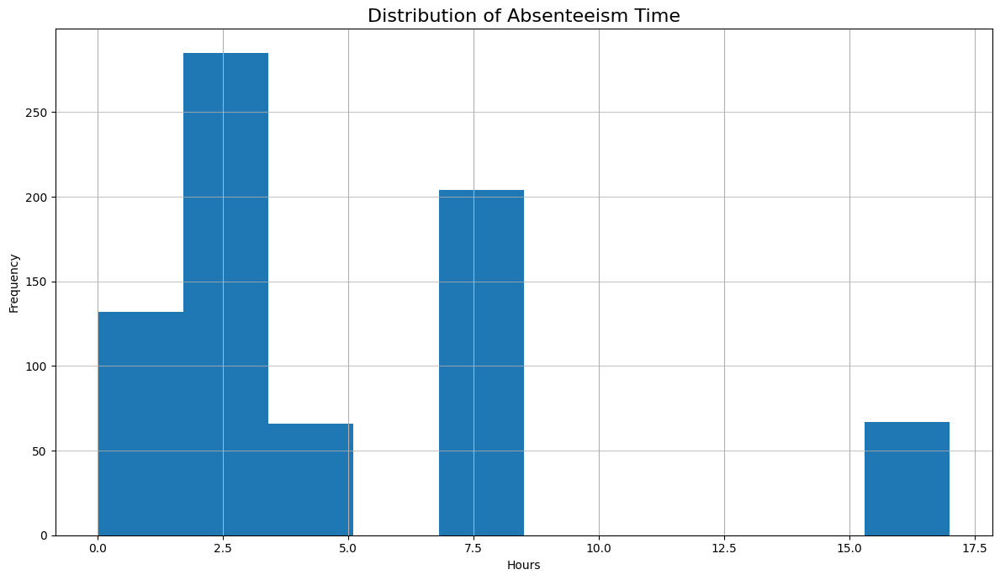

In [ ]:
plt.figure(figsize=(12, 7))
df_copy['Absenteeism time in hours'].hist()
plt.title("Distribution of Absenteeism Time", fontsize=16)
plt.xlabel("Hours")
plt.ylabel("Frequency")
plt.grid(axis='y', alpha=0.75)
plt.show()

In [ ]:
corr = df.corr()
target_corr = corr['Absenteeism time in hours'].sort_values(ascending=False)

print("Correlation with 'Absenteeism time in hours':\n")
print(target_corr)

Correlation with 'Absenteeism time in hours':

Absenteeism time in hours          1.000000
Son                                0.122274
Transportation expense             0.121371
Social drinker                     0.116966
Work load Average/day              0.103350
Height                             0.069410
Weight                             0.029372
Month of absence                   0.014303
Social smoker                      0.010496
Hit target                         0.010469
Distance from Residence to Work   -0.010582
Seasons                           -0.016535
Education                         -0.018163
Age                               -0.021168
Service time                      -0.023421
Pet                               -0.029167
Body mass index                   -0.056909
Day of the week                   -0.114271
Reason for absence                -0.167076
Disciplinary failure              -0.262925
Name: Absenteeism time in hours, dtype: float64


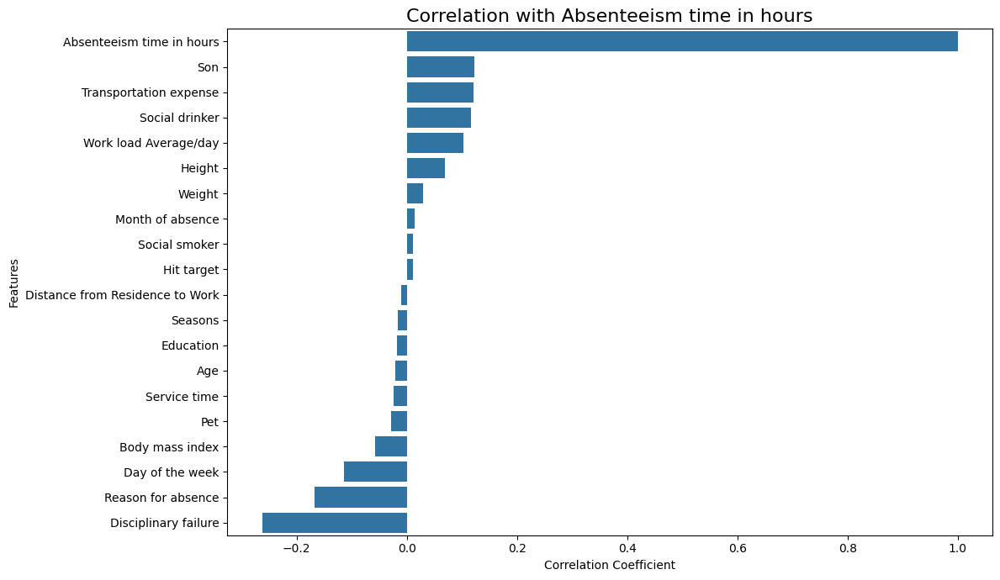

In [ ]:
plt.figure(figsize=(12, 7))
sns.barplot(x=target_corr.values, y=target_corr.index)
plt.title("Correlation with Absenteeism time in hours", fontsize=16)
plt.xlabel("Correlation Coefficient")
plt.ylabel("Features")
plt.show()

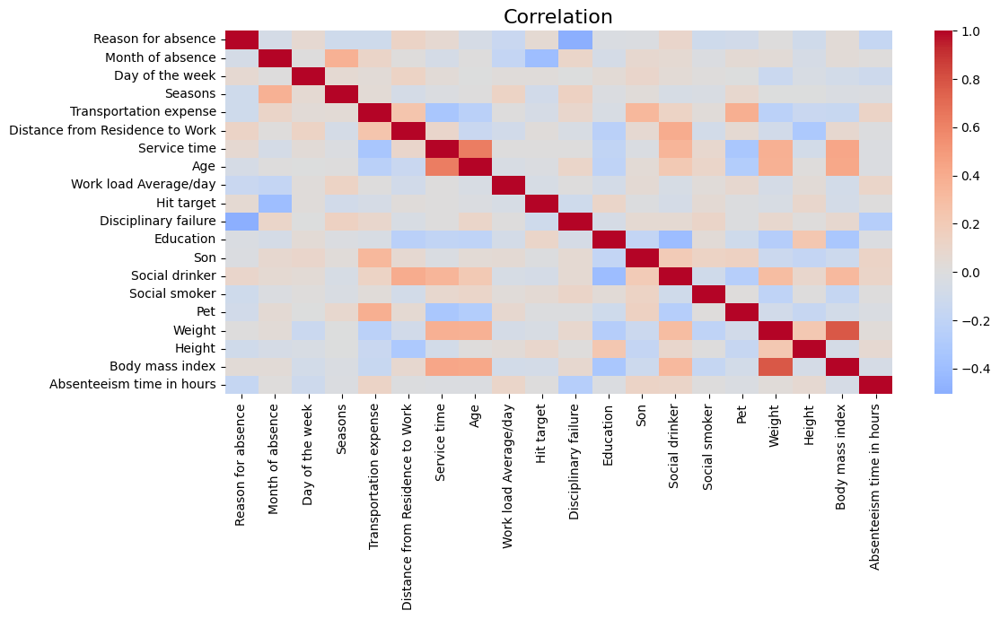

In [ ]:
plt.figure(figsize=(12, 7))
sns.heatmap(corr, annot=False, cmap="coolwarm", center=0)
plt.title("Correlation", fontsize=16)
plt.show()

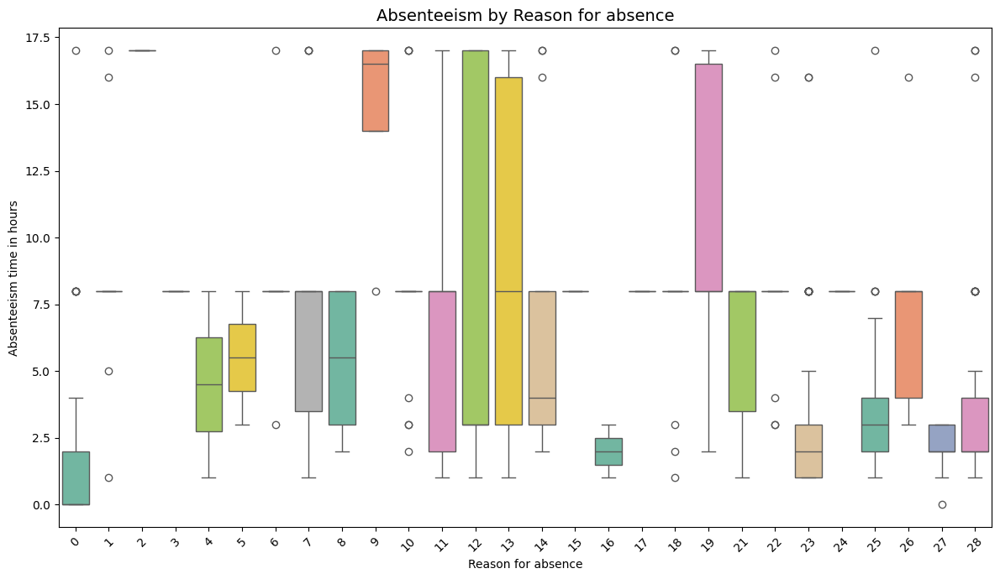

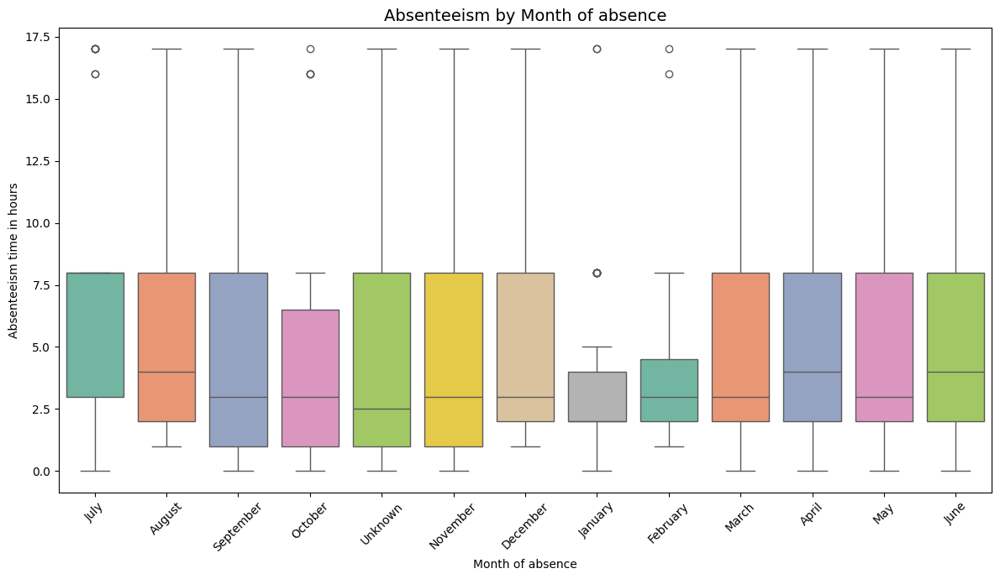

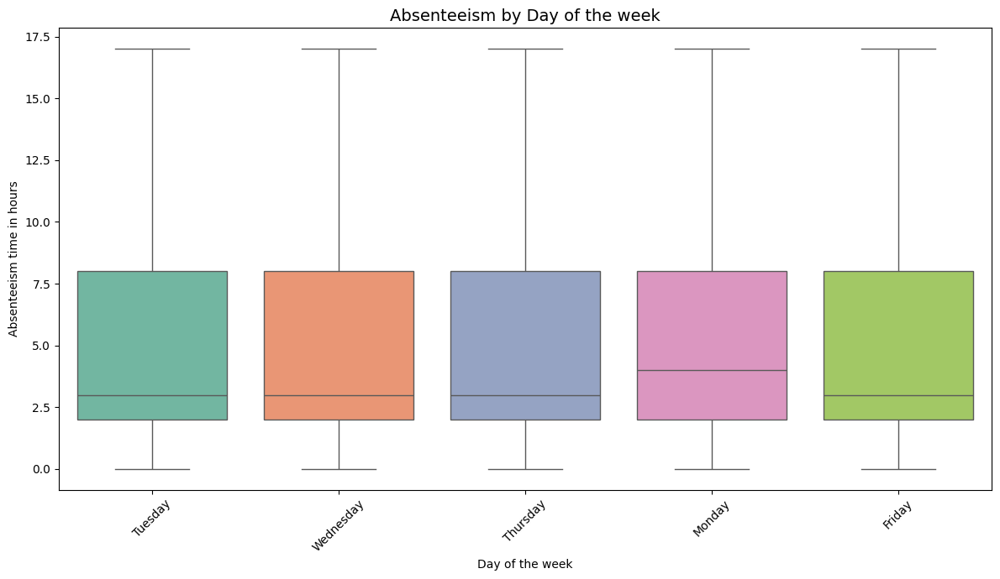

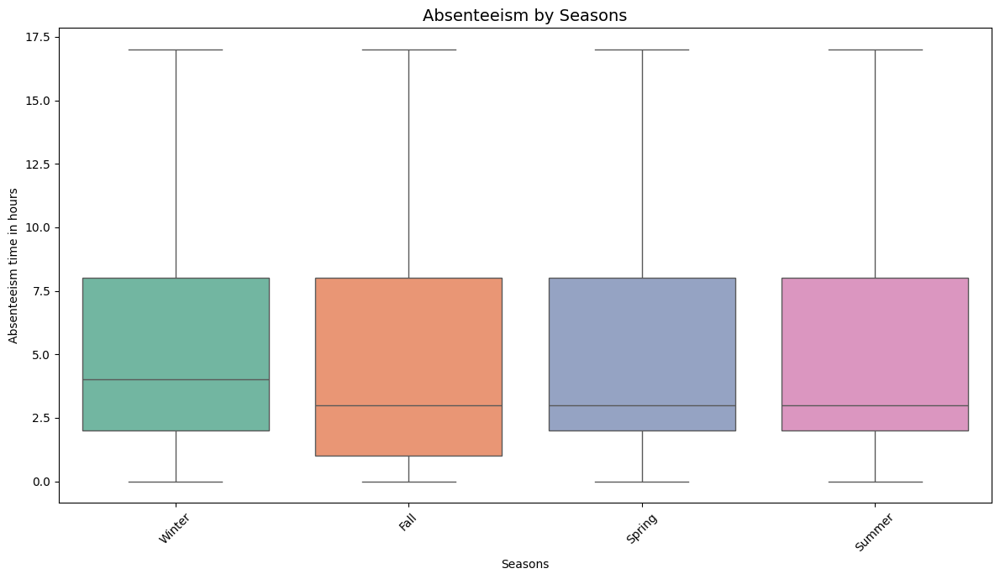

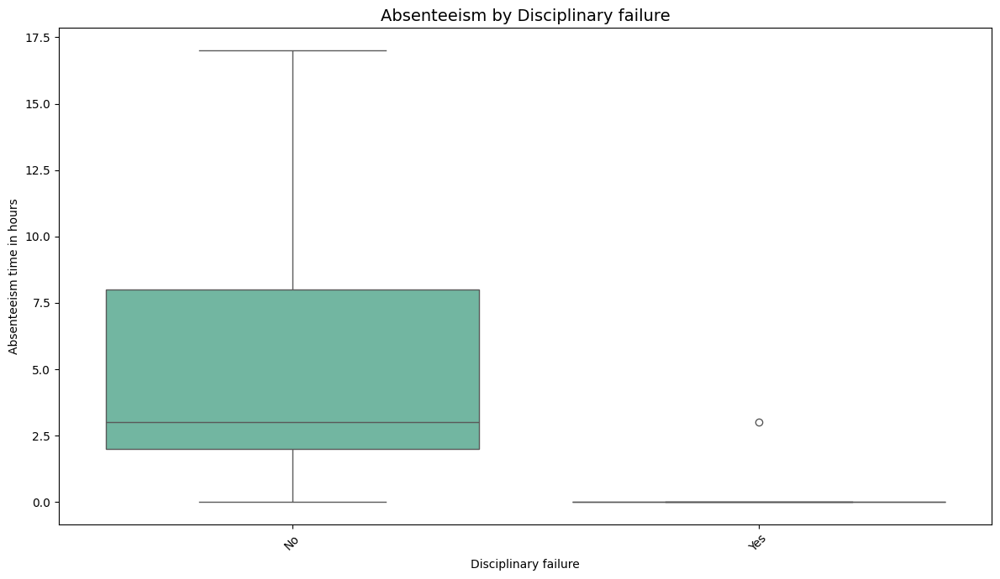

...

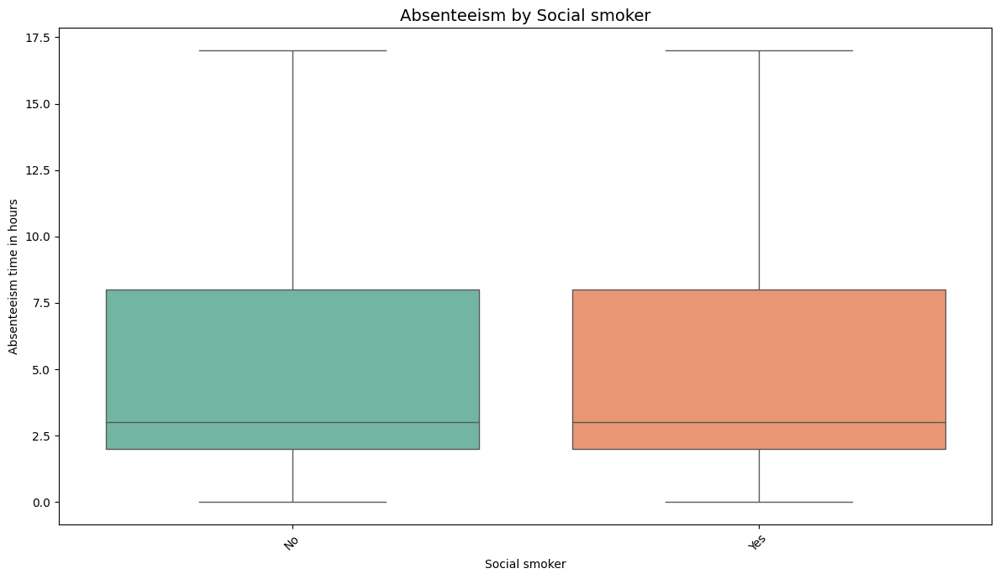

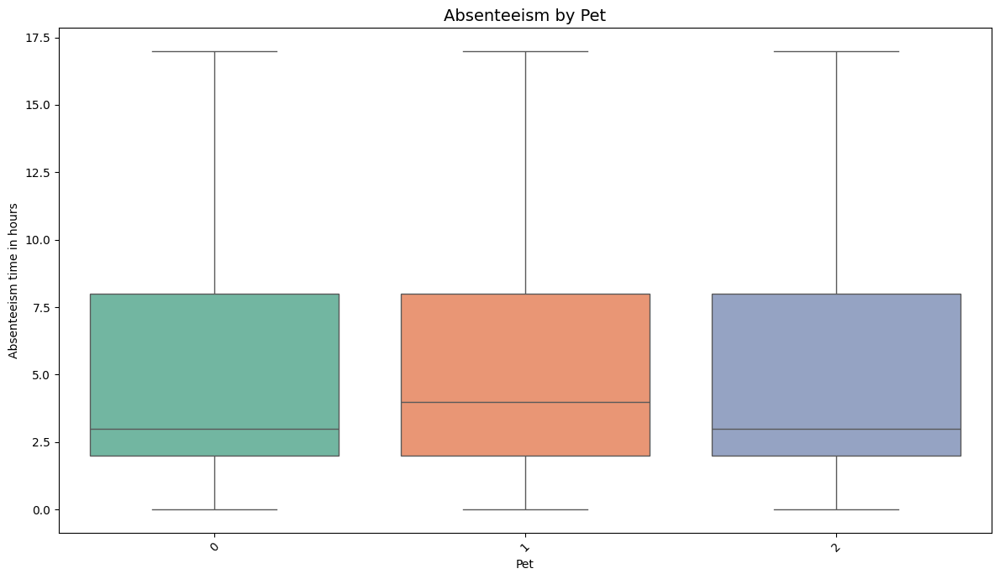

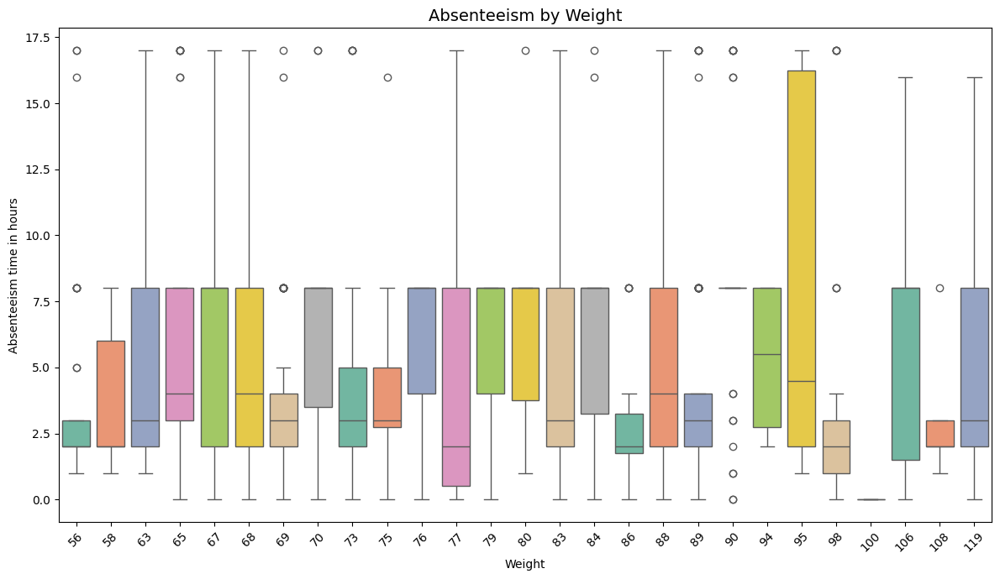

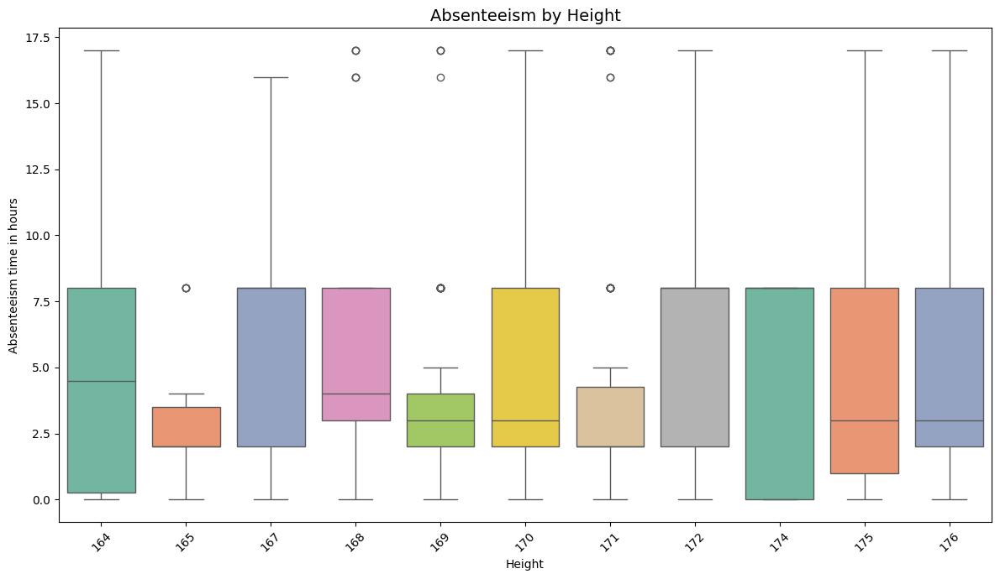

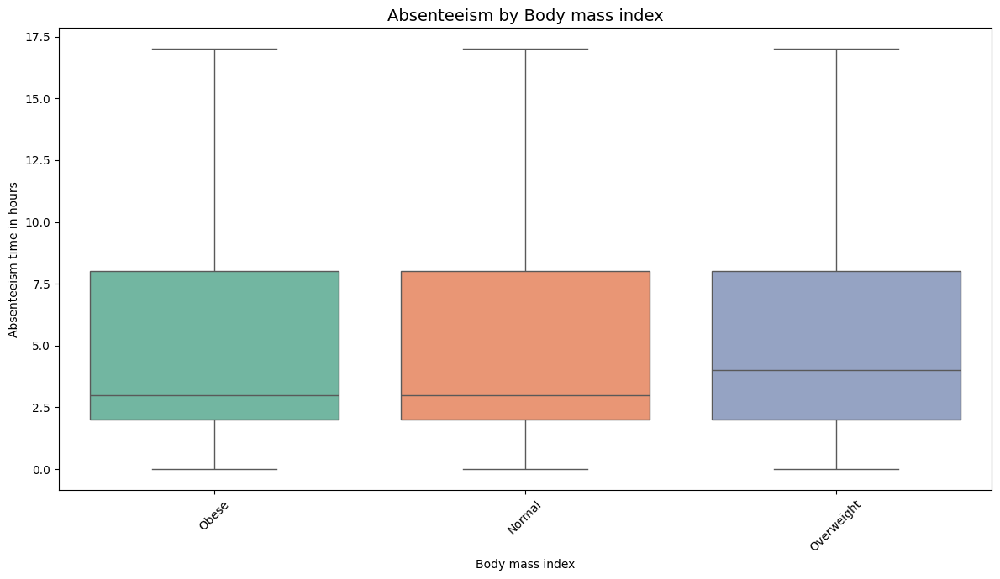

In [ ]:
categorical_cols = ['Reason for absence', 'Month of absence','Day of the week', 'Seasons',
                    'Disciplinary failure', 'Education', 'Son', 'Social drinker', 'Social smoker',
                    'Pet', 'Weight', 'Height', 'Body mass index']

for col in categorical_cols:
    plt.figure(figsize=(12, 7))
    sns.boxplot(x=col, y='Absenteeism time in hours', data=df_copy, palette="Set2", hue=col, legend=False)
    plt.title(f"Absenteeism by {col}", fontsize=14)
    plt.xticks(rotation=45)
    plt.show()